# Sorting Notebook

This notebook will download and sort electrophysiology collected using an Intan headstage, in the .rhd format. 

The data is intracranial mouse recording, from a 16 channel microarray. The paper can be found here: https://doi.org/10.1371/journal.pone.0221510


# Getting Set Up

Open a terminal. Make sure "Sorter" environment is active. 

```
conda deactivate
conda activate sorter
```


In [1]:
from sorting_scripts import zsort

In [2]:
# Set Patient and Session
patient = "patient_1"
session = "session_1"

path_dict = zsort.set_paths(patient, session)
path_dict

0
No .rhd file found in /Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/raw
[set_paths] Could not resolve .rhd under /Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1: list index out of range


{'patient': 'patient_1',
 'session': 'session_1',
 'repo_root': PosixPath('/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/zlab_sorting_script'),
 'data_root': PosixPath('/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data'),
 'session_location': PosixPath('/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1'),
 'sorted_data': PosixPath('/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/patient_1-session_1-sorted'),
 'sorter_output_folder': PosixPath('/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/patient_1-session_1-sorted/patient_1-session_1-sorter_folder'),
 'analyzer_folder': PosixPath('/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/patient_1-session_1-sorted/patient_1-session_1-analyzer_folder'),
 'intan_file': None}

# Load recording into spike interface

In [3]:
from spikeinterface import generation as gen

# Load Recording, creates recording object in memory

rec, drift, sort = gen.generate_drifting_recording(duration = 120)

In [2]:
import spikeinterface.full as si

recording_path = r"/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/intan_rdh/session1/raw/Intan RHD file1.rhd"

rec = si.read_intan(recording_path, stream_id = "0")

FileNotFoundError: /Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/intan_rdh/session1/raw/Intan RHD file1.rhd does not exist

In [4]:
probe = "neuronexus-A16x1_2mm_50_177_A16.json"
rec = zsort.set_probe(rec, path_dict, probe)

Probe already attached!


# Load sorter and analyzer if they exist

# If they do not exist, run the sorter and create analyzer

In [10]:
zsort.sort_stuff(rec, path_dict)

write_binary_recording (no parallelization):   0%|          | 0/1201 [00:00<?, ?it/s]

kilosort.run_kilosort:  
kilosort.run_kilosort: Computing preprocessing variables.
kilosort.run_kilosort: ----------------------------------------
kilosort.run_kilosort: N samples: 24000480
kilosort.run_kilosort: N seconds: 1200.024
kilosort.run_kilosort: N batches: 401
kilosort.run_kilosort: Preprocessing filters computed in 0.94s; total 0.94s
kilosort.run_kilosort:  
kilosort.run_kilosort: Resource usage after preprocessing
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort: CPU usage:    19.50 %
kilosort.run_kilosort: Mem used:     83.10 %     |       6.65 GB
kilosort.run_kilosort: Mem avail:     1.35 /  8.00 GB
kilosort.run_kilosort: ------------------------------------------------------
kilosort.run_kilosort: GPU usage:    N/A
kilosort.run_kilosort: GPU memory:   N/A
kilosort.run_kilosort: ********************************************************
kilosort.run_kilosort:  
kilosort.run_kilosort: Computing drift correction.
kilosort.r

: 

In [6]:
zsort.analyze_stuff(rec, sort, path_dict)

No valid analyzer found, creating a new one
Reason: This folder does not exists /Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/patient_1-session_1-sorted/patient_1-session_1-analyzer_folder


estimate_sparsity (workers: 8 processes):   0%|          | 0/120 [00:00<?, ?it/s]

compute_waveforms (workers: 8 processes):   0%|          | 0/120 [00:00<?, ?it/s]

noise_level (workers: 8 processes):   0%|          | 0/20 [00:00<?, ?it/s]

Fitting PCA:   0%|          | 0/250 [00:00<?, ?it/s]

Projecting waveforms:   0%|          | 0/250 [00:00<?, ?it/s]

Compute : spike_amplitudes (workers: 8 processes):   0%|          | 0/120 [00:00<?, ?it/s]

SortingAnalyzer: 128 channels - 250 units - 1 segments - binary_folder - sparse - has recording
Loaded 11 extensions: random_spikes, waveforms, templates, noise_levels, unit_locations, isi_histograms, correlograms, principal_components, template_similarity, spike_amplitudes, quality_metrics

#### Run the curation gui from the terminal, Make sure to replace with the correct path

```
sigui --mode=web --curation "/Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/patient_1-session_1-sorted/patient_1-session_1-analyzer_folder"
```

In [ ]:
curated_data = zsort.save_curated_data(patient, session, sort, path_dict)

compute_waveforms (no parallelization):   0%|          | 0/120 [00:00<?, ?it/s]

noise_level (no parallelization):   0%|          | 0/20 [00:00<?, ?it/s]

Fitting PCA:   0%|          | 0/244 [00:00<?, ?it/s]

Projecting waveforms:   0%|          | 0/244 [00:00<?, ?it/s]

Compute : spike_amplitudes (no parallelization):   0%|          | 0/120 [00:00<?, ?it/s]

Wrote: /Users/marco/Cursor_Folder/Cursor_Codespace/realtime_sorting/data/patient_1/session_1/patient_1-session_1-sorted/patient_1-session_1-curated_analyzer-v2.zarr


SortingAnalyzer: 128 channels - 244 units - 1 segments - zarr - sparse - has recording
Loaded 11 extensions: isi_histograms, random_spikes, waveforms, templates, unit_locations, noise_levels, principal_components, correlograms, template_similarity, spike_amplitudes, quality_metrics

/opt/anaconda3/envs/sorter311/lib/python3.11/site-packages/spikeinterface/widgets/utils_matplotlib.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  figure = plt.figure(figsize=figsize)


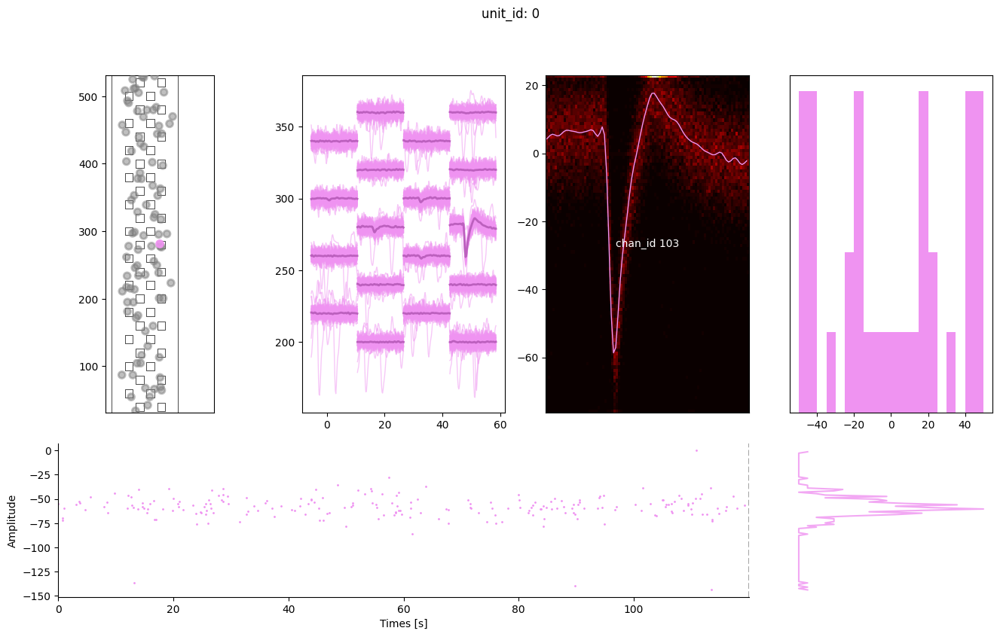

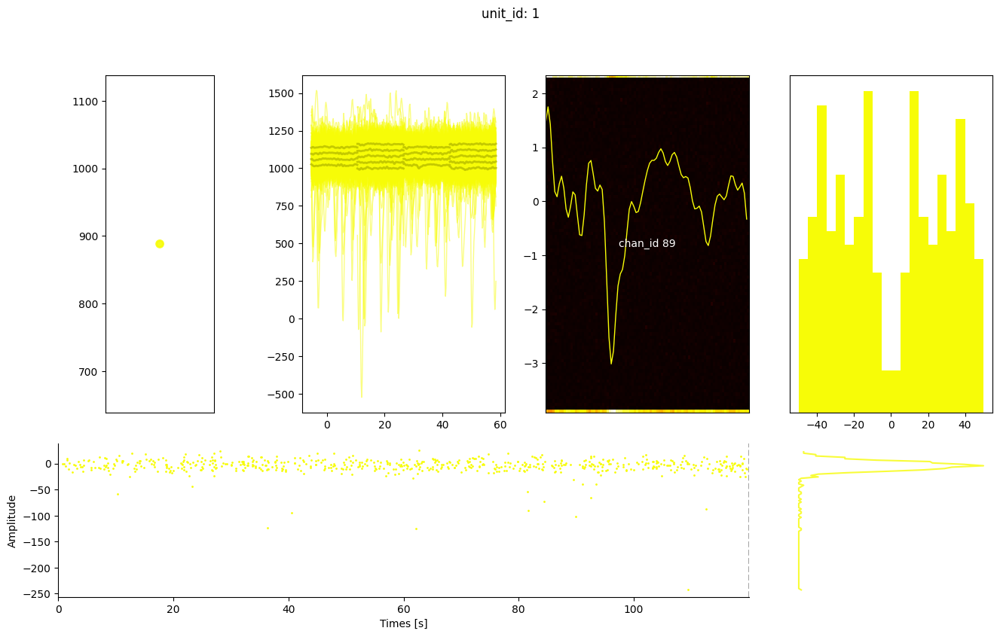

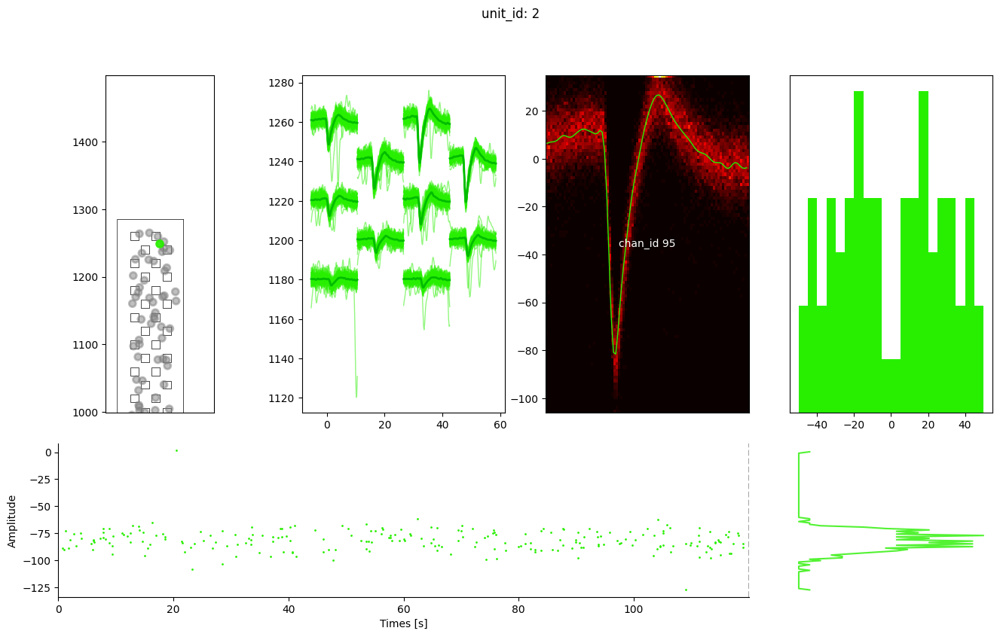

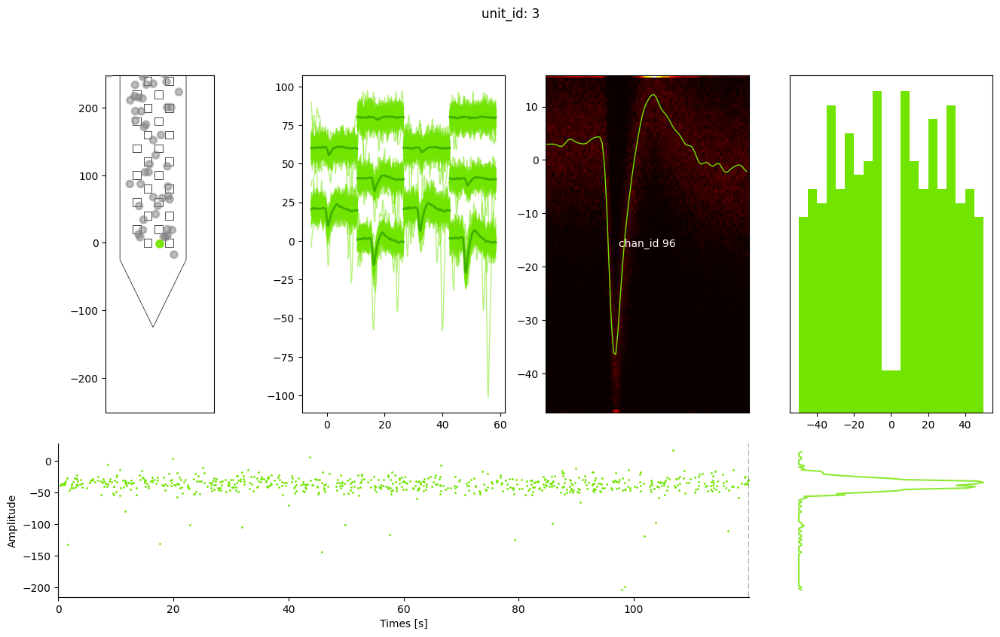

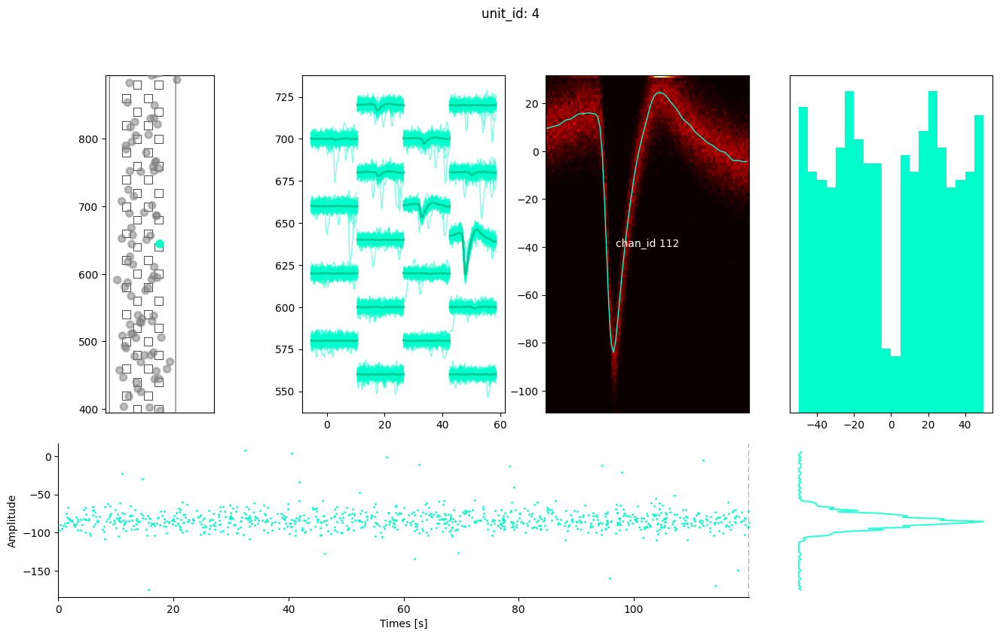

...

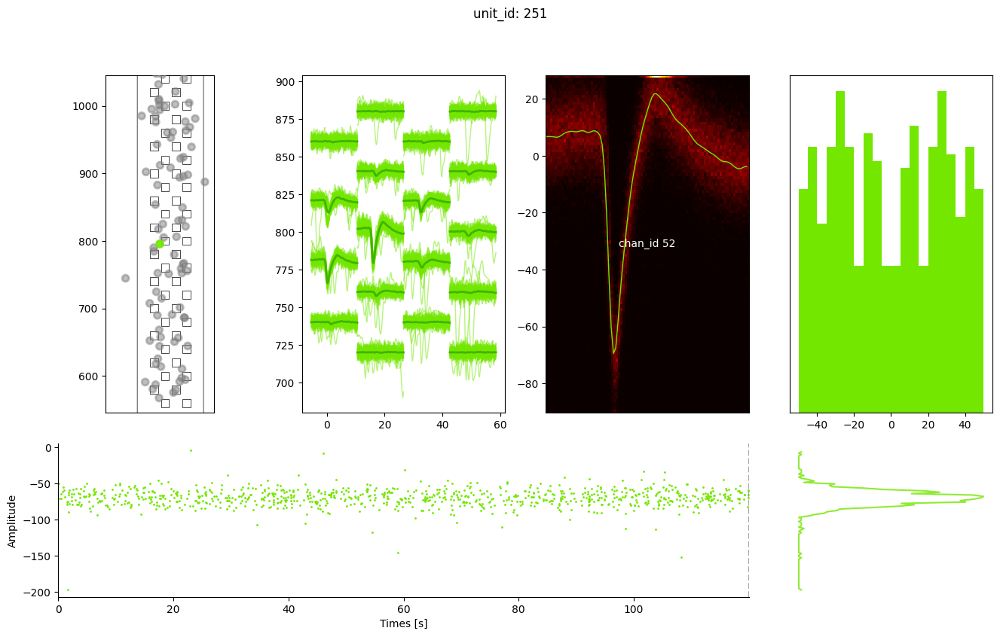

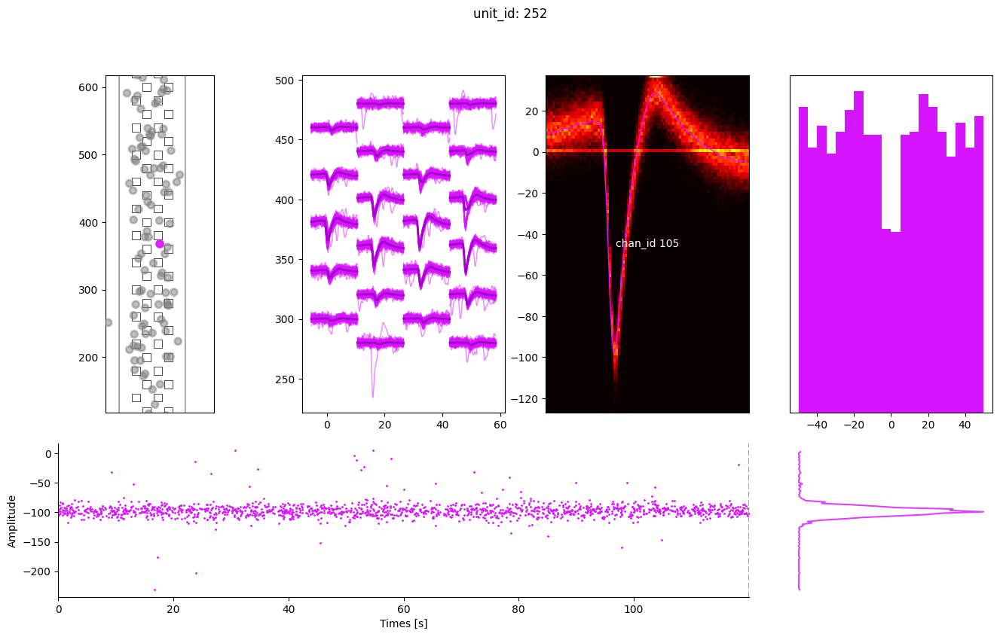

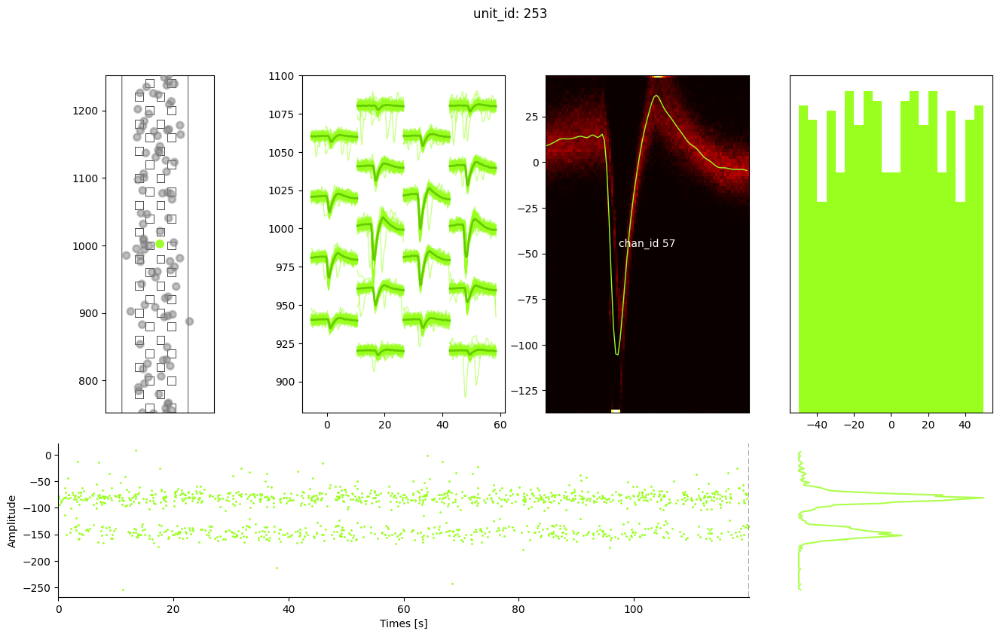

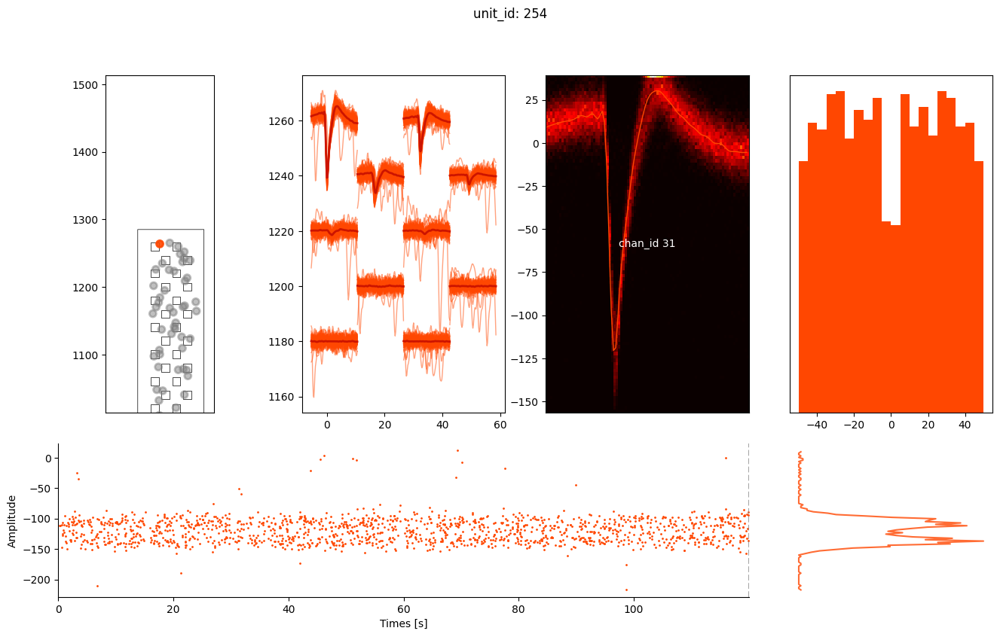

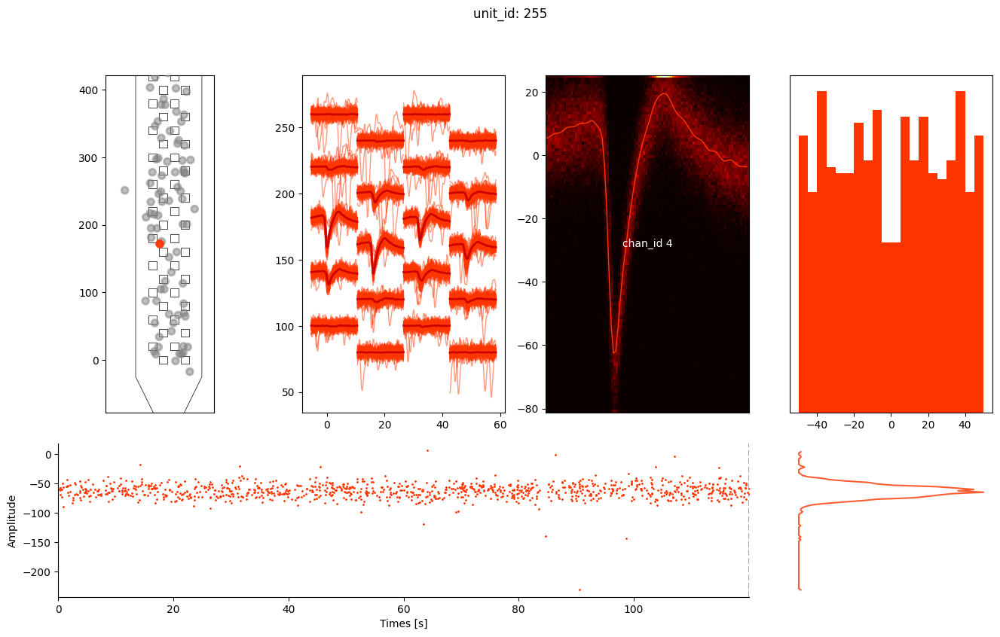

In [7]:
zsort.generate_figures(curated_data, path_dict)

In [ ]:
# Interact with boc via api

!box folders:items 352606395707

----- Folder 352606396623 -----
Type: folder
ID: '352606396623'
Sequence ID: '0'
ETag: '0'
Name: Intan_RDH_2000

----- Folder 354522525287 -----
Type: folder
ID: '354522525287'
Sequence ID: '0'
ETag: '0'
Name: Intan_RDH_2000 (1)


In [28]:
!box folders:items 352606396623

----- Folder 352605477299 -----
Type: folder
ID: '352605477299'
Sequence ID: '0'
ETag: '0'
Name: Session1

----- Folder 352604968054 -----
Type: folder
ID: '352604968054'
Sequence ID: '0'
ETag: '0'
Name: Session2


In [29]:
!box folders:items 352605477299

----- Folder 352607353389 -----
Type: folder
ID: '352607353389'
Sequence ID: '0'
ETag: '0'
Name: raw

----- Folder 354623627238 -----
Type: folder
ID: '354623627238'
Sequence ID: '0'
ETag: '0'
Name: sorted


In [30]:
!box folders:upload 354623627238

Could not read directory 354623627238


In [58]:
!box folders:upload "/home/marco/codespace/data/Intan_RDH_2000/Session1/sorted/cleaned_analyzer.zarr" -p 354623627238

Type: folder
ID: '355655922049'
Sequence ID: '0'
ETag: '0'
Name: cleaned_analyzer.zarr
Created At: '2025-12-12T11:40:22-08:00'
Modified At: '2025-12-12T11:40:22-08:00'
Description: ''
Size: 0
Path Collection:
    Total Count: 5
    Entries:
        -
            Type: folder
            ID: '0'
            Sequence ID: null
            ETag: null
            Name: All Files
        -
            Type: folder
            ID: '352606395707'
            Sequence ID: '0'
            ETag: '0'
            Name: Cloud_Sorter
        -
            Type: folder
            ID: '352606396623'
            Sequence ID: '0'
            ETag: '0'
            Name: Intan_RDH_2000
        -
            Type: folder
            ID: '352605477299'
            Sequence ID: '0'
            ETag: '0'
            Name: Session1
        -
            Type: folder
            ID: '354623627238'
            Sequence ID: '0'
            ETag: '0'
            Name: sorted
Created By:
    Type: user
    ID: '445